In [6]:
import os

annotations_dir = '/content/sample_data/Annotation/'

if os.path.exists(annotations_dir):
    print("Annotation directory exists. Listing files...")
    for root, dirs, files in os.walk(annotations_dir):
        print(f"Found directory: {root}")
        for file in files:
            print(f"File: {file}")
else:
    print("Annotation directory not found!")


Annotation directory not found!


Streaming output truncated to the last 5000 lines.
Images (646, 697): {'Euclidean': 2811.3718, 'Manhattan': 46942.0, 'Cosine': 0.5701544}
Images (646, 698): {'Euclidean': 3086.9768, 'Manhattan': 49076.0, 'Cosine': 0.6130254}
Images (646, 699): {'Euclidean': 2674.8308, 'Manhattan': 47516.0, 'Cosine': 0.52696234}
Images (646, 700): {'Euclidean': 2065.1426, 'Manhattan': 35790.0, 'Cosine': 0.32902163}
Images (646, 701): {'Euclidean': 1997.8348, 'Manhattan': 35080.0, 'Cosine': 0.29984534}
Images (646, 702): {'Euclidean': 2407.4373, 'Manhattan': 41164.0, 'Cosine': 0.38236046}
Images (646, 703): {'Euclidean': 2960.1902, 'Manhattan': 49540.0, 'Cosine': 0.505388}
Images (646, 704): {'Euclidean': 2352.2449, 'Manhattan': 37598.0, 'Cosine': 0.39181828}
Images (646, 705): {'Euclidean': 2388.227, 'Manhattan': 45458.0, 'Cosine': 0.41511792}
Images (646, 706): {'Euclidean': 2022.5815, 'Manhattan': 34176.0, 'Cosine': 0.30610037}
Images (646, 707): {'Euclidean': 2419.6743, 'Manhattan': 42416.0, 'Cosine'

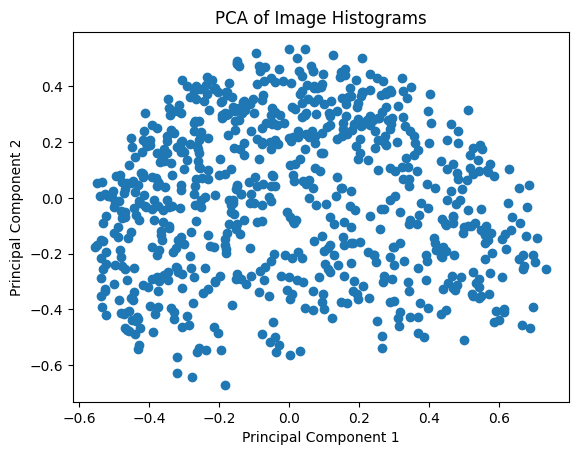

In [4]:
import os
import numpy as np
from PIL import Image
import cv2
from sklearn.decomposition import PCA
from sklearn.preprocessing import normalize
from sklearn.metrics import pairwise
import matplotlib.pyplot as plt
import zipfile

images_folder_path = '/content/Breeds.zip'
extracted_images_path = '/content/Breeds' # Path to extract the images

# Extract the zip file
with zipfile.ZipFile(images_folder_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_images_path)

# Update the path to the extracted directory
images_folder_path = extracted_images_path


dog_images = load_images(images_folder_path)


dog_images = load_images(images_folder_path)

def crop_and_resize_images(images):
    resized_images = []
    for img in images:

        h, w, _ = img.shape
        center_h, center_w = h // 2, w // 2
        cropped_img = img[center_h-50:center_h+50, center_w-50:center_w+50]  # Adjust crop size as needed
        resized_img = cv2.resize(cropped_img, (128, 128), interpolation=cv2.INTER_AREA)
        resized_images.append(resized_img)
    return np.array(resized_images)

# Crop and resize images
cropped_resized_images = crop_and_resize_images(dog_images)

# Function to compute color histograms
def compute_histograms(images):
    histograms = []
    for img in images:

        hist_r = cv2.calcHist([img], [0], None, [256], [0, 256])
        hist_g = cv2.calcHist([img], [1], None, [256], [0, 256])
        hist_b = cv2.calcHist([img], [2], None, [256], [0, 256])
        hist = np.concatenate((hist_r, hist_g, hist_b), axis=0)
        histograms.append(hist.flatten())
    return np.array(histograms)

histograms = compute_histograms(cropped_resized_images)

def compute_similarity_measurements(histograms):
    distances = {}
    for i in range(len(histograms)):
        for j in range(i + 1, len(histograms)):

            euclidean_dist = np.linalg.norm(histograms[i] - histograms[j])
            distances[(i, j)] = {'Euclidean': euclidean_dist}

            manhattan_dist = np.sum(np.abs(histograms[i] - histograms[j]))
            distances[(i, j)]['Manhattan'] = manhattan_dist

            cosine_dist = pairwise.cosine_distances(histograms[i].reshape(1, -1), histograms[j].reshape(1, -1))[0][0]
            distances[(i, j)]['Cosine'] = cosine_dist
    return distances


similarity_measurements = compute_similarity_measurements(histograms)


for key, value in similarity_measurements.items():
    print(f"Images {key}: {value}")


def perform_pca(histograms):
    # Normalize histograms
    histograms_normalized = normalize(histograms)
    pca = PCA(n_components=2)
    reduced_data = pca.fit_transform(histograms_normalized)

    # Plot PCA results
    plt.scatter(reduced_data[:, 0], reduced_data[:, 1])
    plt.title('PCA of Image Histograms')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.show()

# Perform PCA
perform_pca(histograms)


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise
import cv2
import zipfile

images_zip_path = '/content/Breeds.zip'
images_folder_path = '/content/Breeds'  # Extracted directory
cropped_images_path = '/content/sample_data/Cropped_Images'

# Function to unzip files
def unzip_files(zip_file_path, extract_path):
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)

# Unzip the images
unzip_files(images_zip_path, images_folder_path)

# Function to load images (No changes here)
def load_images(folder):
    images = []
    for dirpath, _, files in os.walk(folder):
        for filename in files:
            if filename.endswith(('.png', '.jpg', '.jpeg')):
                img_path = os.path.join(dirpath, filename)
                img = Image.open(img_path).convert('RGB')
                images.append(np.array(img))
    return images


# Function to crop and resize images (No changes here)
def crop_and_resize_images(images, size=(128, 128)):
    cropped_resized_images = []
    for img in images:

        width, height = img.shape[1], img.shape[0]
        left = (width - size[0]) / 2
        top = (height - size[1]) / 2
        right = (width + size[0]) / 2
        bottom = (height + size[1]) / 2

        cropped_img = img[int(top):int(bottom), int(left):int(right)]
        resized_img = cv2.resize(cropped_img, size)
        cropped_resized_images.append(resized_img)
    return cropped_resized_images


def compute_histograms(images):
    histograms = []
    for img in images:
        if len(img.shape) == 2:  # Check if image is grayscale
            hist = cv2.calcHist([img], [0], None, [256], [0, 256])
        else:  # Calculate histogram for each channel if RGB
            hist = cv2.calcHist([img], [0, 1, 2], None, [256, 256, 256], [0, 256, 0, 256, 0, 256])
        histograms.append(hist.flatten())
    return histograms

def compute_similarity_measurements(histograms):
    for i in range(len(histograms)):
        for j in range(i + 1, len(histograms)):
            euclidean_distance = np.linalg.norm(histograms[i] - histograms[j])
            manhattan_distance = np.sum(np.abs(histograms[i] - histograms[j]))
            cosine_distance = 1 - pairwise.cosine_similarity([histograms[i]], [histograms[j]])[0][0]
            print(f'Images ({i}, {j}): {{\'Euclidean\': {euclidean_distance}, \'Manhattan\': {manhattan_distance}, \'Cosine\': {cosine_distance}}}')


def perform_pca(histograms):
    pca = PCA(n_components=2)
    reduced_data = pca.fit_transform(histograms)

    plt.figure(figsize=(20,15))
    plt.scatter(reduced_data[:, 0], reduced_data[:, 1], alpha=0.5)
    plt.title('PCA of Image Histograms')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid()
    plt.show()

def plot_images(images, titles=None, cols=4):  # Reduce number of columns
    n_images = len(images)
    rows = (n_images + cols - 1) // cols
    plt.figure(figsize=(250, 250))  # Increase figure size
    for i in range(n_images):
        plt.subplot(rows, cols, i + 1)
        plt.imshow(images[i].astype(np.uint8))
        plt.axis('off')
        if titles is not None:
            plt.title(titles[i], fontsize=2)  # Reduce font size
   # plt.tight_layout()
    plt.show()

if __name__ == "__main__":

    dog_images = load_images(images_folder_path)

    plot_images(dog_images, titles=[f'Image {i+1}' for i in range(len(dog_images))])

    cropped_resized_images = crop_and_resize_images(dog_images)

    histograms = compute_histograms(cropped_resized_images)

    if histograms: # Check if histograms is not empty before proceeding
        compute_similarity_measurements(histograms)

        perform_pca(histograms)

    plot_images(cropped_resized_images, titles=[f'Cropped Image {i+1}' for i in range(len(cropped_resized_images))])

In [ ]:
import json
file_path = '/train.json'

data = []
with open(file_path, 'r') as file:
    for line in file:
        data.append(json.loads(line))

print(json.dumps(data[0], indent=4))

{
    "ID": "2017-En-20191",
    "Tweet": "Dates in the glove box' is pure panic excuse #GBBO",
    "anger": false,
    "anticipation": true,
    "disgust": true,
    "fear": true,
    "joy": false,
    "love": false,
    "optimism": false,
    "pessimism": false,
    "sadness": true,
    "surprise": false,
    "trust": false
}


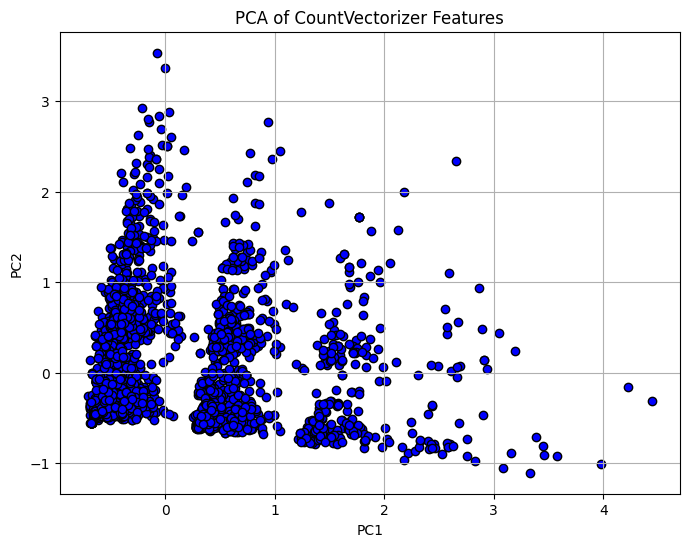

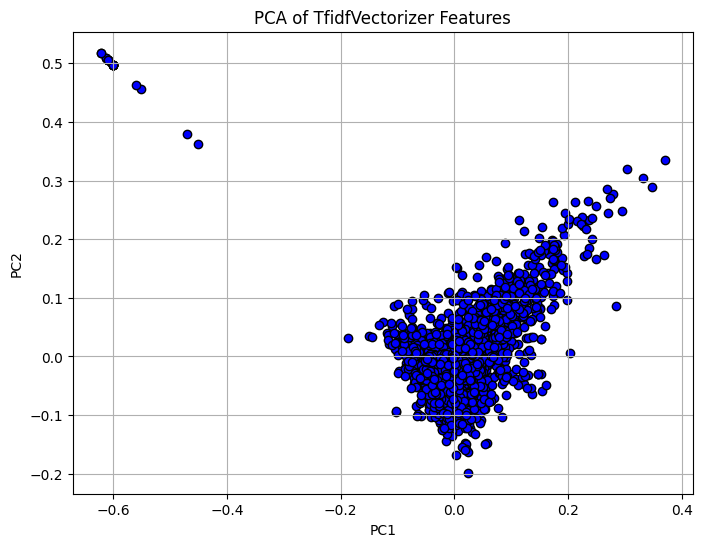

Dimensionality of CountVectorizer representation: (3000, 9683)
Dimensionality of TfidfVectorizer representation: (3000, 9683)


In [ ]:
import json
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

file_path = 'train.json'
data = []
with open(file_path, 'r') as file:
    for line in file:
        data.append(json.loads(line))

texts = [entry['Tweet'] for entry in data]

count_vectorizer = CountVectorizer()
count_vectors = count_vectorizer.fit_transform(texts)

tfidf_vectorizer = TfidfVectorizer()
tfidf_vectors = tfidf_vectorizer.fit_transform(texts)

pca = PCA(n_components=2)
count_pca = pca.fit_transform(count_vectors.toarray())
tfidf_pca = pca.fit_transform(tfidf_vectors.toarray())

def plot_pca(pca_result, title):
    plt.figure(figsize=(8, 6))
    plt.scatter(pca_result[:, 0], pca_result[:, 1], c='blue', marker='o', edgecolor='k')
    plt.title(title)
    plt.xlabel('PC1')
    plt.ylabel('PC2')
    plt.grid(True)
    plt.show()

# CountVectorizer
plot_pca(count_pca, 'PCA of CountVectorizer Features')

# TfidfVectorizer
plot_pca(tfidf_pca, 'PCA of TfidfVectorizer Features')

count_dimensionality = count_vectors.shape
tfidf_dimensionality = tfidf_vectors.shape

print(f"Dimensionality of CountVectorizer representation: {count_dimensionality}")
print(f"Dimensionality of TfidfVectorizer representation: {tfidf_dimensionality}")




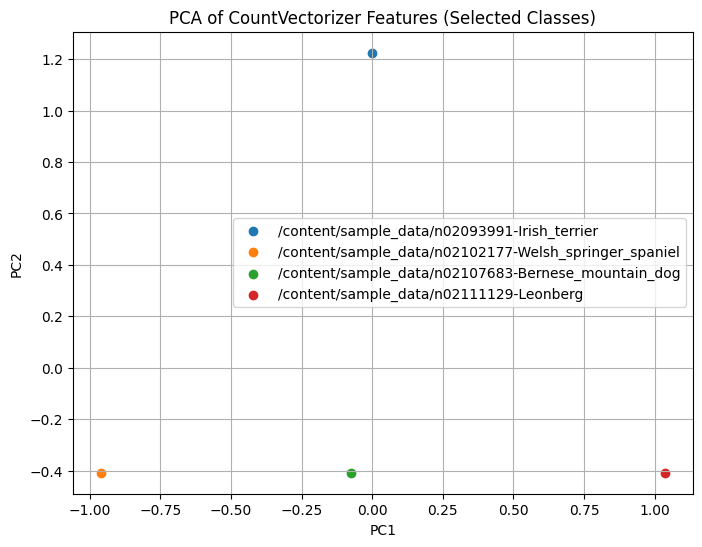

In [13]:
# Import necessary libraries
import os
import tarfile
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, exposure
from skimage.feature import hog
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise
from sklearn.feature_extraction.text import CountVectorizer


data = [
    {'Tweet': '/content/sample_data/n02093991-Irish_terrier', 'Class': '/content/sample_data/n02093991-Irish_terrier'}, # Added 'Class' key to the first dictionary
    {'Tweet': '/content/sample_data/n02102177-Welsh_springer_spaniel', 'Class': '/content/sample_data/n02102177-Welsh_springer_spaniel'},
    {'Tweet': '/content/sample_data/n02107683-Bernese_mountain_dog', 'Class': '/content/sample_data/n02107683-Bernese_mountain_dog'},
    {'Tweet': '/content/sample_data/n02111129-Leonberg', 'Class': '/content/sample_data/n02111129-Leonberg'},
]

selected_classes = ['/content/sample_data/n02093991-Irish_terrier', '/content/sample_data/n02102177-Welsh_springer_spaniel', '/content/sample_data/n02107683-Bernese_mountain_dog', '/content/sample_data/n02111129-Leonberg']  # Replace with your actual class labels

filtered_data = [entry for entry in data if entry['Class'] in selected_classes]

filtered_texts = [entry['Tweet'] for entry in filtered_data]
filtered_classes = [entry['Class'] for entry in filtered_data]


count_vectorizer = CountVectorizer()
count_vectors = count_vectorizer.fit_transform(filtered_texts)

count_vectors_filtered = count_vectorizer.transform(filtered_texts)
pca_count_filtered = PCA(n_components=2).fit_transform(count_vectors_filtered.toarray())


plt.figure(figsize=(8, 6))
for class_label in selected_classes:
  indices = [i for i, cls in enumerate(filtered_classes) if cls == class_label]
  plt.scatter(pca_count_filtered[indices, 0], pca_count_filtered[indices, 1], label=class_label)

plt.title('PCA of CountVectorizer Features (Selected Classes)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.grid(True)
plt.show()

# 8. Plot PCA results for TfidfVectorizer features (if applicable)
# ...

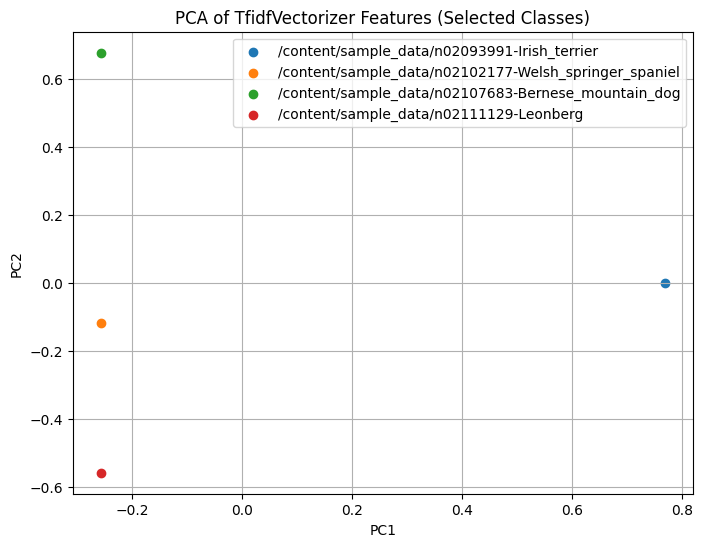

In [14]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

data = [
    {'Tweet': '/content/sample_data/n02093991-Irish_terrier', 'Class': '/content/sample_data/n02093991-Irish_terrier'}, # Added 'Class' key to the first dictionary
    {'Tweet': '/content/sample_data/n02102177-Welsh_springer_spaniel', 'Class': '/content/sample_data/n02102177-Welsh_springer_spaniel'},
    {'Tweet': '/content/sample_data/n02107683-Bernese_mountain_dog', 'Class': '/content/sample_data/n02107683-Bernese_mountain_dog'},
    {'Tweet': '/content/sample_data/n02111129-Leonberg', 'Class': '/content/sample_data/n02111129-Leonberg'},
]

selected_classes = ['/content/sample_data/n02093991-Irish_terrier', '/content/sample_data/n02102177-Welsh_springer_spaniel', '/content/sample_data/n02107683-Bernese_mountain_dog', '/content/sample_data/n02111129-Leonberg']  # Replace with your actual class labels


filtered_data = [entry for entry in data if entry['Class'] in selected_classes]


filtered_texts = [entry['Tweet'] for entry in filtered_data]
filtered_classes = [entry['Class'] for entry in filtered_data]

tfidf_vectorizer = TfidfVectorizer()
tfidf_vectors = tfidf_vectorizer.fit_transform(filtered_texts)


tfidf_vectors_filtered = tfidf_vectorizer.transform(filtered_texts)
pca_tfidf_filtered = PCA(n_components=2).fit_transform(tfidf_vectors_filtered.toarray())


plt.figure(figsize=(8, 6))
for class_label in selected_classes:
  indices = [i for i, cls in enumerate(filtered_classes) if cls == class_label]
  plt.scatter(pca_tfidf_filtered[indices, 0], pca_tfidf_filtered[indices, 1], label=class_label)

plt.title('PCA of TfidfVectorizer Features (Selected Classes)')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.grid(True)
plt.show()